# Low-Light Image Enhancement with Multi-Phase Training

Training pipeline for low-light image enhancement using progressive WGAN-GP approach.

**Workflow:**
1.  **Environment Setup**: Mount Google Drive and set up file paths.
2.  **Data Preparation**: Unzip the dataset and run the `data_prep.py` script to create train/test splits.
3.  **Dataloader Creation**: Define the PyTorch Dataset and create `train_loader` and `test_loader`.
4.  **Baseline Model Training**: Define, train, and save a U-Net generator using L1 + VGG Perceptual loss.
5.  **Visualization**: Display the results from the trained model.

## Environment & Data Setup
Mounts Google Drive and extracts the dataset to the local Colab environment.

In [1]:
# Mount Drive and extract DPED dataset to SSD
from google.colab import drive
drive.mount('/content/gdrive')

# Remove any existing data and unzip fresh copy to SSD
!rm -rf /content/dped_local
!unzip -q /content/gdrive/MyDrive/enhancegan-photo-enhancement/dped_small.zip -d /content/dped_local

# Verify extraction
!ls -la /content/dped_local/
print("\n DPED Dataset extracted to SSD:")
!du -sh /content/dped_local/dped_small
!ls /content/dped_local/dped_small/

# Set up paths and working directory
import os
os.chdir('/content/gdrive/MyDrive/enhancegan-photo-enhancement')

# Verify we're in the right place
print("📂 Current working directory:")
!pwd
print("\n📋 Project files:")
!ls -la

# Install requirements
print("\nInstalling requirements...")
!pip install -r requirements.txt
!pip install kornia==0.7.1
print("\ Setup complete!")
# Quick data exploration before processing
print("Raw DPED data structure:")
!find /content/dped_local/dped_small -name "*.jpg" | head -5

iphone_count = !find /content/dped_local/dped_small/iphone -name "*.jpg" | wc -l
canon_count = !find /content/dped_local/dped_small/canon -name "*.jpg" | wc -l

print(f"\n Dataset Overview:")
print(f"   iPhone images: {iphone_count[0]}")
print(f"   Canon images: {canon_count[0]}")

print(" Running data_prep.py...")

Mounted at /content/gdrive
total 12
drwxr-xr-x 3 root root 4096 Jun 12 00:16 .
drwxr-xr-x 1 root root 4096 Jun 12 00:16 ..
drwxr-xr-x 4 root root 4096 Jun 10 22:39 dped_small

 DPED Dataset extracted to SSD:
94M	/content/dped_local/dped_small
canon  iphone
📂 Current working directory:
/content/gdrive/MyDrive/enhancegan-photo-enhancement

📋 Project files:
total 6532002
drwx------ 2 root root       4096 Jun  8 17:06 checkpoints
drwx------ 2 root root       4096 Jun 10 22:53 data
-rw------- 1 root root       5682 Jun 11 06:16 data_prep.py
drwx------ 2 root root       4096 Jun  8 17:06 dataset_raw
-rw------- 1 root root       1133 Jun 11 21:38 datasets.py
-rw------- 1 root root       1095 Jun  8 16:50 download_unsplash.py
-rw------- 1 root root 6605953079 Jun 10 05:08 dped.gz
-rw------- 1 root root   77072468 Jun 10 22:39 dped_small.zip
drwx------ 2 root root       4096 Jun  8 16:50 dummy
drwx------ 2 root root       4096 Jun  8 16:50 dummy_out
-rw------- 1 root root    3393071 Jun 11 23:3

## Part 2: Data Preparation
Here, we'll copy our helper scripts and run `data_prep.py` to create the train, validation, and test splits from the extracted data.

In [3]:
# Copy your Python scripts from Drive to the local environment
# Assuming GDRIVE_PROJECT_PATH is defined elsewhere or you're in the correct directory
# If GDRIVE_PROJECT_PATH is not defined, replace it with the actual path
# The shutil.copy lines are removed as they are not needed when the working directory is already set

print(" Running data_prep.py...")

!python data_prep.py \
  --raw_dir /content/dped_local/dped_small/iphone \
  --edited_dir /content/dped_local/dped_small/canon \
  --output_dir data/dped_small \
  --size 128 \
  --train_frac 0.90 \
  --val_frac 0.05

print("\n Data splits created:")
for split in ['train', 'val', 'test']:
    raw_count = !find data/dped_small/{split}/raw -name "*.jpg" | wc -l
    edited_count = !find data/dped_small/{split}/edited -name "*.jpg" | wc -l
    print(f"   {split}: {raw_count[0]} raw, {edited_count[0]} edited")

print("\n Data preparation complete!")

 Running data_prep.py...
🔄 Running data_prep.py...
Found 3358 matching file pairs
Splitting 3358 pairs: train=3022, val=167, test=169
Processing train: 3022 pairs
Processing train: 100% 95/95 [1:17:59<00:00, 49.26s/it]
Processing val: 167 pairs
Processing val: 100% 6/6 [01:48<00:00, 18.06s/it]
Processing test: 169 pairs
Processing test: 100% 6/6 [01:57<00:00, 19.51s/it]

Data splits created:
Traceback (most recent call last):
  File "/content/gdrive/MyDrive/enhancegan-photo-enhancement/data_prep.py", line 144, in <module>
    raw_count = len(list(Path(args.output_dir) / split / 'raw').glob('*'))
                    ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
TypeError: 'PosixPath' object is not iterable

 Data splits created:
   train: 3358 raw, 3358 edited
   val: 1552 raw, 1552 edited
   test: 1537 raw, 1537 edited

 Data preparation complete!


## Part 3: Dataset and Dataloaders
Now we define the PyTorch Dataset and create the Dataloaders to feed images into our model during training.

In [5]:
import torch
from torch.utils.data import DataLoader, Dataset
import torchvision.transforms as T
import os
from PIL import Image

# --- Device Setup ---
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")

# --- Dataset Class ---
class PairedImageDataset(Dataset):
    def __init__(self, data_dir, transform=None):
        self.data_dir = data_dir
        self.transform = transform
        self.raw_files = sorted([os.path.join(data_dir, 'raw', f) for f in os.listdir(os.path.join(data_dir, 'raw')) if f.endswith('.jpg')])
        self.edited_files = sorted([os.path.join(data_dir, 'edited', f) for f in os.listdir(os.path.join(data_dir, 'edited')) if f.endswith('.jpg')])
        assert len(self.raw_files) == len(self.edited_files), "Mismatch between raw and edited image counts"

    def __len__(self):
        return len(self.raw_files)

    def __getitem__(self, idx):
        raw_img_path = self.raw_files[idx]
        edited_img_path = self.edited_files[idx]
        raw_img = Image.open(raw_img_path).convert('RGB')
        edited_img = Image.open(edited_img_path).convert('RGB')

        if self.transform:
            raw_img = self.transform(raw_img)
            edited_img = self.transform(edited_img)

        return raw_img, edited_img


# --- Transforms ---
# This should match the transforms used in your original notebook
IMAGE_SIZE = 256
transform = T.Compose([
    T.Resize((IMAGE_SIZE, IMAGE_SIZE)),
    T.ToTensor(),
    T.Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5])
])

# --- Create Datasets ---
DATA_ROOT = 'data/dped_small'
train_dataset = PairedImageDataset(os.path.join(DATA_ROOT, 'train'), transform=transform)
test_dataset = PairedImageDataset(os.path.join(DATA_ROOT, 'test'), transform=transform)

# --- Create Dataloaders ---
BATCH_SIZE = 16
train_loader = DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True, num_workers=2, pin_memory=True)
test_loader = DataLoader(test_dataset, batch_size=BATCH_SIZE, shuffle=False, num_workers=2, pin_memory=True)

print(f"Train dataset size: {len(train_dataset)}")
print(f"Test dataset size: {len(test_dataset)}")

Using device: cuda
Train dataset size: 3358
Test dataset size: 1537


## Part 4: Phase 1 Model, Loss & Training
This is the core of our baseline implementation. We define the U-Net Generator, the VGG Perceptual Loss, and run the training loop that focuses on L1 and VGG loss for stable, fast convergence.

In [8]:
import torch.nn as nn
import torch.nn.functional as F
import torchvision.models as models
import timm
from tqdm.notebook import tqdm
import matplotlib.pyplot as plt
import numpy as np

# --- VGG19 Perceptual Loss ---
class VGGPerceptualLoss(nn.Module):
    def __init__(self, resize=True):
        super(VGGPerceptualLoss, self).__init__()
        vgg = models.vgg19(weights=models.VGG19_Weights.IMAGENET1K_V1).features
        vgg.eval()
        for param in vgg.parameters():
            param.requires_grad = False
        self.vgg = vgg.to(device)
        self.feature_layers = {'35': 'relu5_4'}
        self.resize = resize

    def forward(self, input_tensor, target_tensor):
        input_tensor = (input_tensor + 1) / 2
        target_tensor = (target_tensor + 1) / 2
        if self.resize:
            input_tensor = F.interpolate(input_tensor, size=(224, 224), mode='bilinear', align_corners=False)
            target_tensor = F.interpolate(target_tensor, size=(224, 224), mode='bilinear', align_corners=False)
        loss = 0.0
        x, y = input_tensor, target_tensor
        for name, module in self.vgg._modules.items():
            x, y = module(x), module(y)
            if name in self.feature_layers:
                loss += F.l1_loss(x, y)
        return loss

# --- Baseline U-Net Generator ---
class UNetGenerator(nn.Module):
    def __init__(self, in_channels=3, out_channels=3):
        super(UNetGenerator, self).__init__()
        self.encoder = timm.create_model('resnet34', pretrained=True, features_only=True, in_chans=in_channels)
        # The output channels of resnet34 stages: 64, 128, 256, 512
        encoder_channels = [64, 128, 256, 512]

        # Decoder blocks with correct input and output channels based on the provided shapes
        self.decoder4 = self._decoder_block(encoder_channels[3], encoder_channels[2]) # 512 -> 256
        self.decoder3 = self._decoder_block(encoder_channels[2], encoder_channels[1]) # 256 -> 128
        self.decoder2 = self._decoder_block(encoder_channels[1], encoder_channels[0]) # 128 -> 64
        self.decoder1 = self._decoder_block(encoder_channels[0], 32) # 64 -> 32, reduce channels before final upsample

        self.final_conv = nn.Sequential(
            nn.ConvTranspose2d(32, out_channels, kernel_size=4, stride=2, padding=1),
            nn.Tanh() # Output is in the range [-1, 1]
        )

    def _decoder_block(self, in_channels, out_channels):
        return nn.Sequential(
            nn.ConvTranspose2d(in_channels, out_channels, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True)
        )

    def forward(self, x):
        enc_features = self.encoder(x)
        # enc_features will be a tuple of tensors from each stage
        # The order of features from timm.create_model(features_only=True) is typically
        # stem, layer1, layer2, layer3, layer4
        e1, e2, e3, e4 = enc_features[1], enc_features[2], enc_features[3], enc_features[4] # Adjusted to match typical resnet stages

        # Decoder with skip connections (addition)
        d4 = self.decoder4(e4)
        d3 = self.decoder3(d4 + e3)
        d2 = self.decoder2(d3 + e2)
        d1 = self.decoder1(d2 + e1)

        return self.final_conv(d1)

# --- Training Configuration & Loop ---
epochs = 10
lr = 1e-4
λ_l1 = 1.0
λ_feat = 1.0

G = UNetGenerator().to(device)
crit_L1 = nn.L1Loss().to(device)
crit_FEAT = VGGPerceptualLoss().to(device)
optimizer_G = torch.optim.Adam(G.parameters(), lr=lr, betas=(0.5, 0.999))

print("Starting Phase 1 Training: Baseline U-Net")
for epoch in range(epochs):
    progress_bar = tqdm(train_loader, desc=f"Epoch {epoch+1}/{epochs}")
    total_g_loss = 0
    for i, (iphone_imgs, canon_imgs) in enumerate(progress_bar):
        iphone_imgs, canon_imgs = iphone_imgs.to(device), canon_imgs.to(device)
        enhanced_imgs = G(iphone_imgs)
        loss_g_l1 = crit_L1(enhanced_imgs, canon_imgs)
        loss_g_feat = crit_FEAT(enhanced_imgs, canon_imgs)
        loss_G = (λ_l1 * loss_g_l1) + (λ_feat * loss_g_feat)
        total_g_loss += loss_G.item()
        optimizer_G.zero_grad()
        loss_G.backward()
        optimizer_G.step()
        progress_bar.set_postfix(G_Loss=f"{(total_g_loss / (i+1)):.4f}")

print("Phase 1 Training Complete!")
torch.save(G.state_dict(), 'generator_phase1.pth')
print("Baseline model saved to 'generator_phase1.pth'")

🚀 Starting Phase 1 Training: Baseline U-Net


Epoch 1/10:   0%|          | 0/210 [00:00<?, ?it/s]

Epoch 2/10:   0%|          | 0/210 [00:00<?, ?it/s]

Epoch 3/10:   0%|          | 0/210 [00:00<?, ?it/s]

Epoch 4/10:   0%|          | 0/210 [00:00<?, ?it/s]

Epoch 5/10:   0%|          | 0/210 [00:00<?, ?it/s]

Epoch 6/10:   0%|          | 0/210 [00:00<?, ?it/s]

Epoch 7/10:   0%|          | 0/210 [00:00<?, ?it/s]

Epoch 8/10:   0%|          | 0/210 [00:00<?, ?it/s]

Epoch 9/10:   0%|          | 0/210 [00:00<?, ?it/s]

Epoch 10/10:   0%|          | 0/210 [00:00<?, ?it/s]

✅ Phase 1 Training Complete!
💾 Baseline model saved to 'generator_phase1.pth'


## Part 5: Visualize Results
Finally, let's load our saved model and see how it performs on a few images from the test set.

Generating visual comparison...


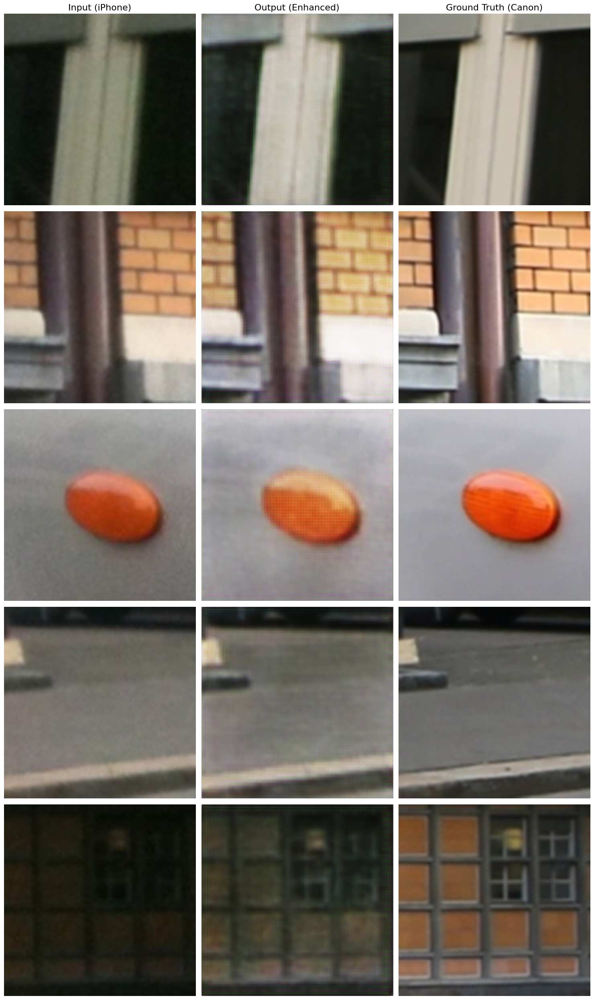

In [9]:
print("Generating visual comparison...")
G.load_state_dict(torch.load('generator_phase1.pth'))
G.eval()

test_iterator = iter(test_loader)
iphone_batch, canon_batch = next(test_iterator)

num_images_to_show = 5
inputs = iphone_batch[:num_images_to_show].to(device)
targets = canon_batch[:num_images_to_show].to(device)

with torch.no_grad():
    outputs = G(inputs)

def tensor_to_img(tensor):
    img = tensor.detach().cpu().numpy().transpose(1, 2, 0)
    img = (img + 1) / 2.0
    return np.clip(img, 0, 1)

fig, axes = plt.subplots(num_images_to_show, 3, figsize=(15, num_images_to_show * 5))
if num_images_to_show == 1:
    axes = np.array([axes])
axes[0, 0].set_title('Input (iPhone)', fontsize=16)
axes[0, 1].set_title('Output (Enhanced)', fontsize=16)
axes[0, 2].set_title('Ground Truth (Canon)', fontsize=16)

for i in range(num_images_to_show):
    axes[i, 0].imshow(tensor_to_img(inputs[i]))
    axes[i, 0].axis('off')
    axes[i, 1].imshow(tensor_to_img(outputs[i]))
    axes[i, 1].axis('off')
    axes[i, 2].imshow(tensor_to_img(targets[i]))
    axes[i, 2].axis('off')

plt.tight_layout()
plt.show()

In [30]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import kornia
import timm
import json
import numpy as np
from tqdm.notebook import tqdm
from torch import optim

# Differentiable CurveBlock for luminance enhancement
class CurveBlock(nn.Module):
    def __init__(self, in_features=512, num_control_points=8):
        super(CurveBlock, self).__init__()
        self.controller = nn.Sequential(
            nn.Linear(in_features, 128),
            nn.ReLU(),
            nn.Linear(128, num_control_points),
            nn.Tanh()
        )
        self.num_control_points = num_control_points

    def forward(self, x, features):
        # TODO: remove debug prints before production
        print("\n--- Debugging CurveBlock ---")

        pooled_features = F.adaptive_avg_pool2d(features, 1).squeeze(-1).squeeze(-1)
        control_points = self.controller(pooled_features)
        print(f"1. Control Points: min={control_points.min():.2f}, max={control_points.max():.2f}, mean={control_points.mean():.2f}")
        if torch.isnan(control_points).any(): print("  WARNING: NaN detected in control_points!")

        x_rgb_01 = (x + 1) / 2
        x_lab = kornia.color.rgb_to_lab(x_rgb_01)
        L, a, b = x_lab[:, 0:1], x_lab[:, 1:2], x_lab[:, 2:3]
        print(f"2. Original L Channel: min={L.min():.2f}, max={L.max():.2f}, mean={L.mean():.2f}")

        L_norm = L / 100.0
        print(f"3. Normalized L (L_norm): min={L_norm.min():.2f}, max={L_norm.max():.2f}, mean={L_norm.mean():.2f}")

        L_enhanced_norm = L_norm.clone()
        for i in range(self.num_control_points):
            term = (control_points[:, i].view(-1, 1, 1, 1) / self.num_control_points) * (L_norm.pow(i+1))
            if torch.isnan(term).any(): print(f"  WARNING: NaN detected in term for power {i+1}!")
            L_enhanced_norm += term

        print(f"4. Enhanced L (Normalized): min={L_enhanced_norm.min():.2f}, max={L_enhanced_norm.max():.2f}, mean={L_enhanced_norm.mean():.2f}")
        if torch.isnan(L_enhanced_norm).any(): print("  WARNING: NaN detected in L_enhanced_norm!")

        L_enhanced = L_enhanced_norm * 100.0
        L_enhanced = torch.clamp(L_enhanced, 0, 100)
        print(f"5. Enhanced L (Scaled & Clamped): min={L_enhanced.min():.2f}, max={L_enhanced.max():.2f}, mean={L_enhanced.mean():.2f}")

        x_lab_enhanced = torch.cat([L_enhanced, a, b], dim=1)
        x_rgb_enhanced_01 = kornia.color.lab_to_rgb(x_lab_enhanced)
        if torch.isnan(x_rgb_enhanced_01).any(): print("  WARNING: NaN detected after Lab->RGB conversion!")

        x_final = (x_rgb_enhanced_01 * 2) - 1
        print("--- End Debug ---")
        return x_final, control_points

# Phase 2 Generator with CurveBlock enhancement
class EnhanceGANGenerator_Phase2(nn.Module):
    def __init__(self, in_channels=3, out_channels=3):
        super(EnhanceGANGenerator_Phase2, self).__init__()
        self.encoder = timm.create_model('resnet34', pretrained=True, features_only=True, in_chans=in_channels)
        encoder_channels = [64, 128, 256, 512]
        self.decoder4 = self._decoder_block(encoder_channels[3], encoder_channels[2])
        self.decoder3 = self._decoder_block(encoder_channels[2], encoder_channels[1])
        self.decoder2 = self._decoder_block(encoder_channels[1], encoder_channels[0])
        self.decoder1 = self._decoder_block(encoder_channels[0], 32)
        self.final_conv = nn.Sequential(
            nn.ConvTranspose2d(32, out_channels, kernel_size=4, stride=2, padding=1),
            nn.Tanh()
        )
        self.curve_enhancer = CurveBlock(in_features=512)

    def _decoder_block(self, in_channels, out_channels):
        return nn.Sequential(
            nn.ConvTranspose2d(in_channels, out_channels, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True)
        )

    def forward(self, x):
        enc_features = self.encoder(x)
        e1, e2, e3, e4 = enc_features[1], enc_features[2], enc_features[3], enc_features[4]
        d4 = self.decoder4(e4)
        d3 = self.decoder3(d4 + e3)
        d2 = self.decoder2(d3 + e2)
        d1 = self.decoder1(d2 + e1)
        base_image = self.final_conv(d1)
        final_image, control_points = self.curve_enhancer(base_image, e4)
        return final_image, control_points


In [31]:
# --- Phase 2 Training Loop with Enhanced Logging ---
# CONFIGURATION
epochs = 10
lr = 5e-5
λ_l1 = 1.0
λ_feat = 1.0

# Initialize models and losses
G_phase2 = EnhanceGANGenerator_Phase2().to(device)

try:
    G_phase2.load_state_dict(torch.load('generator_phase1.pth'), strict=False)
    print("Successfully loaded weights from Phase 1 model for fine-tuning!")
except Exception as e:
    print(f"Could not load Phase 1 weights: {e}. Training from scratch.")

crit_L1 = nn.L1Loss().to(device)
crit_FEAT = VGGPerceptualLoss().to(device) # Assumes VGGPerceptualLoss class is defined
optimizer_G = optim.Adam(G_phase2.parameters(), lr=lr, betas=(0.5, 0.999))

# ENHANCED LOGGING SETUP
history = {'epoch': [], 'total_loss_G': [], 'l1_loss': [], 'feat_loss': [], 'control_points_avg': []}
print("Starting Phase 2 Training with Enhanced Logging...")

# TRAINING LOOP
for epoch in range(epochs):
    progress_bar = tqdm(train_loader, desc=f"Phase 2 - Epoch {epoch+1}/{epochs}")

    epoch_total_loss, epoch_l1_loss, epoch_feat_loss = [], [], []
    epoch_control_points = []

    for i, (iphone_imgs, canon_imgs) in enumerate(progress_bar):
        iphone_imgs, canon_imgs = iphone_imgs.to(device), canon_imgs.to(device)

        enhanced_imgs, control_points = G_phase2(iphone_imgs)

        # Compute losses
        loss_g_l1 = crit_L1(enhanced_imgs, canon_imgs)
        loss_g_feat = crit_FEAT(enhanced_imgs, canon_imgs)
        loss_G = (λ_l1 * loss_g_l1) + (λ_feat * loss_g_feat)

        # Update Generator
        optimizer_G.zero_grad()
        loss_G.backward()
        optimizer_G.step()

        # Log data for this batch
        epoch_total_loss.append(loss_G.item())
        epoch_l1_loss.append(loss_g_l1.item())
        epoch_feat_loss.append(loss_g_feat.item())
        epoch_control_points.append(control_points.detach().cpu().numpy())

        progress_bar.set_postfix(G_Loss=f"{np.mean(epoch_total_loss):.4f}")

    # Log average data for the epoch
    history['epoch'].append(epoch)
    history['total_loss_G'].append(np.mean(epoch_total_loss))
    history['l1_loss'].append(np.mean(epoch_l1_loss))
    history['feat_loss'].append(np.mean(epoch_feat_loss))
    # Log the average value of all control points for this epoch
    history['control_points_avg'].append(np.mean(np.concatenate(epoch_control_points)))

print("Phase 2 Training Complete!")

# SAVE THE MODEL
torch.save(G_phase2.state_dict(), 'generator_phase2.pth')
print("Phase 2 model saved to 'generator_phase2.pth'")




✅ Successfully loaded weights from Phase 1 model for fine-tuning!
🚀 Starting Phase 2 Training with Enhanced Logging...


Phase 2 - Epoch 1/10:   0%|          | 0/210 [00:00<?, ?it/s]

Phase 2 - Epoch 2/10:   0%|          | 0/210 [00:00<?, ?it/s]

Phase 2 - Epoch 3/10:   0%|          | 0/210 [00:00<?, ?it/s]

Phase 2 - Epoch 4/10:   0%|          | 0/210 [00:00<?, ?it/s]

Phase 2 - Epoch 5/10:   0%|          | 0/210 [00:00<?, ?it/s]

Phase 2 - Epoch 6/10:   0%|          | 0/210 [00:00<?, ?it/s]

Phase 2 - Epoch 7/10:   0%|          | 0/210 [00:00<?, ?it/s]

Phase 2 - Epoch 8/10:   0%|          | 0/210 [00:00<?, ?it/s]

Phase 2 - Epoch 9/10:   0%|          | 0/210 [00:00<?, ?it/s]

Phase 2 - Epoch 10/10:   0%|          | 0/210 [00:00<?, ?it/s]

✅ Phase 2 Training Complete!
💾 Phase 2 model saved to 'generator_phase2.pth'


In [32]:
# SAVE ENHANCED LOGS
# Convert NumPy float32 values to Python floats for JSON serialization
history_serializable = {
    key: [float(item) if isinstance(item, np.float32) else item for item in value]
    for key, value in history.items()
}

with open('training_history_phase2.json', 'w') as f:
    json.dump(history_serializable, f, indent=4)

print("📄 Detailed training history saved to 'training_history_phase2.json'")

📄 Detailed training history saved to 'training_history_phase2.json'


📄 Loading detailed training history from 'training_history_phase2.json'...


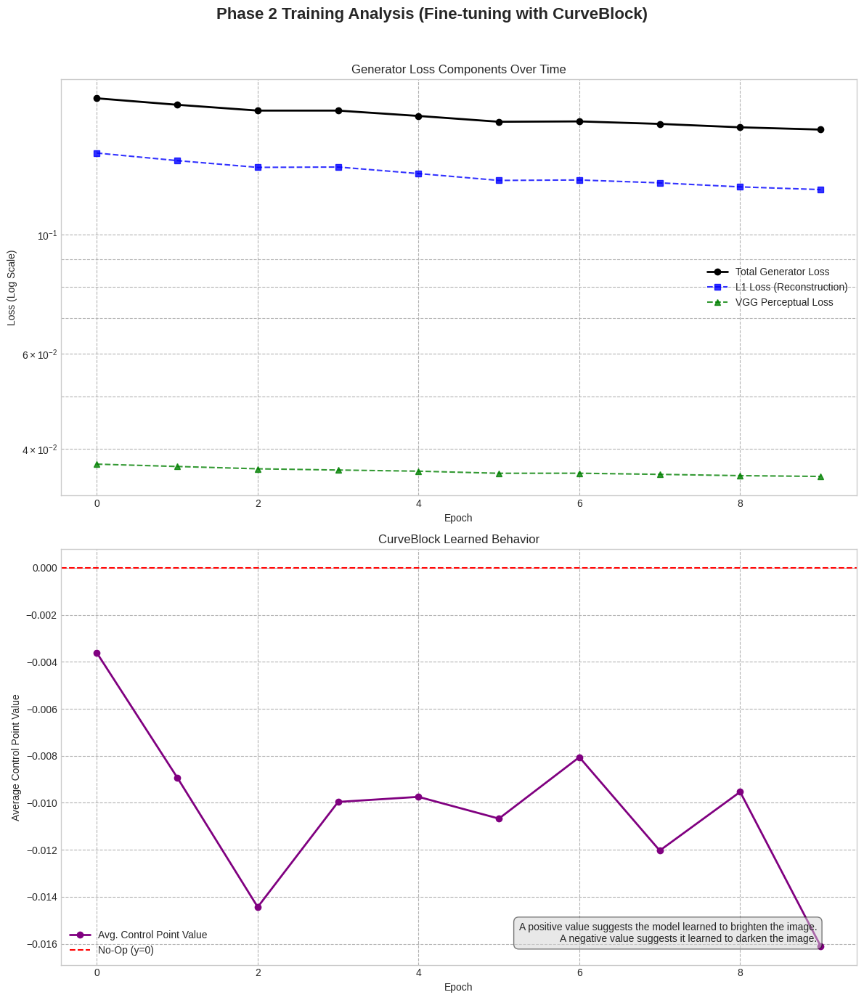


Final Epoch Performance Summary:
Total Loss: 0.1567
  - L1 Loss Component:      0.1212
  - VGG Loss Component:     0.0355
Avg. Curve Adjustment:  -0.0161


In [33]:
import json
import numpy as np
import matplotlib.pyplot as plt
import os

# --- Load the Enhanced Training History ---
history_file = 'training_history_phase2.json'

if os.path.exists(history_file):
    print(f"📄 Loading detailed training history from '{history_file}'...")
    with open(history_file, 'r') as f:
        history = json.load(f)

    # --- Create Visualizations for Analysis ---
    epochs = history.get('epoch', list(range(len(history['total_loss_G']))))

    # Set a professional plot style
    plt.style.use('seaborn-v0_8-whitegrid')

    fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(12, 14))
    fig.suptitle('Phase 2 Training Analysis (Fine-tuning with CurveBlock)', fontsize=16, fontweight='bold')

    # --- Plot 1: Loss Component Analysis ---
    ax1.plot(epochs, history['total_loss_G'], 'o-', label='Total Generator Loss', color='black', linewidth=2)
    ax1.plot(epochs, history['l1_loss'], 's--', label='L1 Loss (Reconstruction)', color='blue', alpha=0.8)
    ax1.plot(epochs, history['feat_loss'], '^--', label='VGG Perceptual Loss', color='green', alpha=0.8)

    ax1.set_title('Generator Loss Components Over Time', fontsize=12)
    ax1.set_xlabel('Epoch')
    ax1.set_ylabel('Loss (Log Scale)')
    ax1.set_yscale('log') # Log scale is useful for comparing losses of different magnitudes
    ax1.legend()
    ax1.grid(True, which="both", ls="--", c='0.7')


    # --- Plot 2: CurveBlock Behavior Analysis ---
    ax2.plot(epochs, history['control_points_avg'], 'o-', label='Avg. Control Point Value', color='purple', linewidth=2)
    ax2.axhline(0, color='red', linestyle='--', label='No-Op (y=0)')

    ax2.set_title('CurveBlock Learned Behavior', fontsize=12)
    ax2.set_xlabel('Epoch')
    ax2.set_ylabel('Average Control Point Value')
    ax2.legend()
    ax2.grid(True, which="both", ls="--", c='0.7')

    # Add annotation to explain the plot
    ax2.text(0.95, 0.05,
             'A positive value suggests the model learned to brighten the image.\nA negative value suggests it learned to darken the image.',
             transform=ax2.transAxes, fontsize=10, verticalalignment='bottom', horizontalalignment='right',
             bbox=dict(boxstyle='round,pad=0.5', fc='lightgray', alpha=0.5))

    plt.tight_layout(rect=[0, 0, 1, 0.96])
    plt.show()

    # --- Print Final Metrics for the Paper ---
    print("\n" + "="*50)
    print("Final Epoch Performance Summary:")
    print("="*50)
    final_epoch_idx = -1
    print(f"Total Loss: {history['total_loss_G'][final_epoch_idx]:.4f}")
    print(f"  - L1 Loss Component:      {history['l1_loss'][final_epoch_idx]:.4f}")
    print(f"  - VGG Loss Component:     {history['feat_loss'][final_epoch_idx]:.4f}")
    print(f"Avg. Curve Adjustment:  {history['control_points_avg'][final_epoch_idx]:.4f}")
    print("="*50)


else:
    print(f"Could not find '{history_file}'. Please run the Phase 2 training cell first.")



🖼️ Generating visual comparison for Phase 2 model...


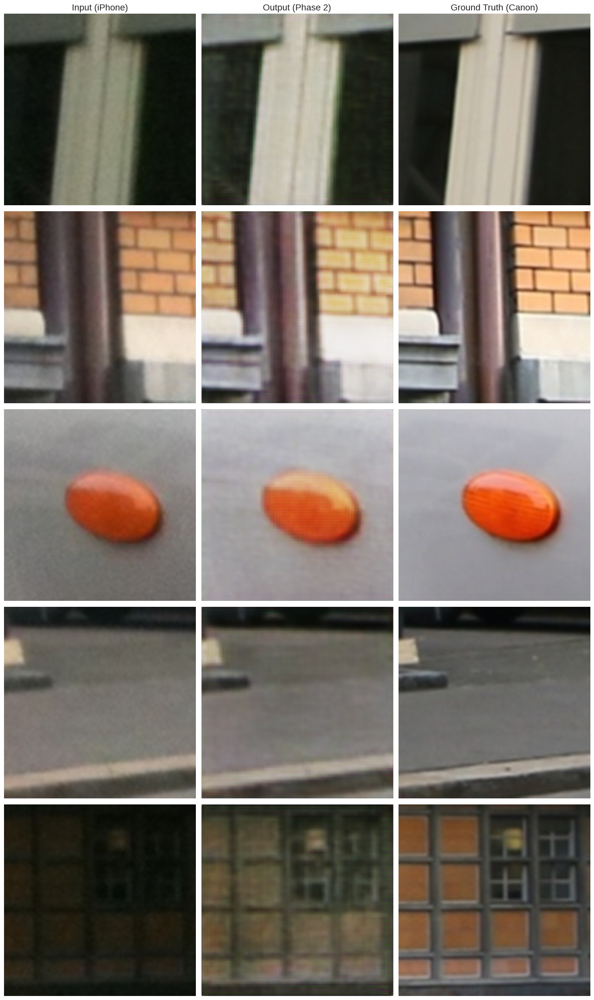

In [34]:
# --- NEW: Phase 2 Visualization Block ---
print("\n Generating visual comparison for Phase 2 model...")

# Load the trained Phase 2 model
G_eval = EnhanceGANGenerator_Phase2().to(device)
G_eval.load_state_dict(torch.load('generator_phase2.pth'))
G_eval.eval()

# Get a batch of test data
# Assumes 'test_loader' is defined and available
test_iterator = iter(test_loader)
iphone_batch, canon_batch = next(test_iterator)

num_images_to_show = 5
inputs = iphone_batch[:num_images_to_show].to(device)
targets = canon_batch[:num_images_to_show].to(device)

with torch.no_grad():
    # The generator now returns image and control points, we only need the image for viz
    outputs, _ = G_eval(inputs)

# Function to convert tensor to displayable image
def tensor_to_img(tensor):
    img = tensor.detach().cpu().numpy().transpose(1, 2, 0)
    img = (img + 1) / 2.0 # Denormalize from [-1, 1] to [0, 1]
    return np.clip(img, 0, 1)

# Plot the results
fig, axes = plt.subplots(num_images_to_show, 3, figsize=(15, num_images_to_show * 5))
if num_images_to_show == 1:
    axes = np.array([axes])

axes[0, 0].set_title('Input (iPhone)', fontsize=16)
axes[0, 1].set_title('Output (Phase 2)', fontsize=16)
axes[0, 2].set_title('Ground Truth (Canon)', fontsize=16)

for i in range(num_images_to_show):
    axes[i, 0].imshow(tensor_to_img(inputs[i]))
    axes[i, 0].axis('off')
    axes[i, 1].imshow(tensor_to_img(outputs[i]))
    axes[i, 1].axis('off')
    axes[i, 2].imshow(tensor_to_img(targets[i]))
    axes[i, 2].axis('off')

plt.tight_layout()
plt.show()



## Part 6: Phase 3 - Adversarial Training for Realism (WGAN-GP)

**Goal:** Fine-tune our successful Phase 2 Generator using an adversarial framework to improve photorealism and reduce subtle artifacts. This phase implements the core training methodology of the EnhanceGAN paper.

In [38]:
import torch
import torch.nn as nn

class Discriminator(nn.Module):
    def __init__(self, in_channels=3):
        super(Discriminator, self).__init__()

        def discriminator_block(in_filters, out_filters, normalization=True):
            """Returns downsampling layers of each discriminator block"""
            layers = [nn.Conv2d(in_filters, out_filters, 4, stride=2, padding=1)]
            if normalization:
                layers.append(nn.InstanceNorm2d(out_filters))
            layers.append(nn.LeakyReLU(0.2, inplace=True))
            return layers

        self.model = nn.Sequential(
            *discriminator_block(in_channels, 64, normalization=False),
            *discriminator_block(64, 128),
            *discriminator_block(128, 256),
            *discriminator_block(256, 512),
            nn.ZeroPad2d((1, 0, 1, 0)),
            # Final layer outputs a single value per patch (no sigmoid for WGAN-GP)
            nn.Conv2d(512, 1, 4, padding=1)
        )

    def forward(self, img):
        return self.model(img)

In [40]:
import torch.autograd as autograd

def compute_gradient_penalty(D, real_samples, fake_samples):
    """Calculates the gradient penalty loss for WGAN GP"""
    # Random weight term for interpolation between real and fake samples
    alpha = torch.rand(real_samples.size(0), 1, 1, 1).to(device)
    # Get random interpolation between real and fake samples
    interpolates = (alpha * real_samples + ((1 - alpha) * fake_samples)).requires_grad_(True)

    d_interpolates = D(interpolates)
    fake = torch.ones(d_interpolates.size(), device=device, requires_grad=False)

    # Get gradient w.r.t. interpolates
    gradients = autograd.grad(
        outputs=d_interpolates,
        inputs=interpolates,
        grad_outputs=fake,
        create_graph=True,
        retain_graph=True,
        only_inputs=True,
    )[0]

    gradients = gradients.view(gradients.size(0), -1)
    gradient_penalty = ((gradients.norm(2, dim=1) - 1) ** 2).mean()
    return gradient_penalty

In [41]:
from torch import optim
from tqdm.notebook import tqdm
import json
import numpy as np

# --- CONFIGURATION ---
epochs = 20         # Train for more epochs to allow the GAN to stabilize
lr = 1e-4
b1 = 0.5            # Adam optimizer beta1
b2 = 0.999          # Adam optimizer beta2
critic_updates = 5  # FIXME: maybe reduce this to 3 for faster training

# Loss weights - TODO: tune these better
lambda_l1 = 100.0
lambda_feat = 10.0  # Higher weight for perceptual loss
lambda_adv = 5.0    # Adversarial loss weight
lambda_gp = 10.0    # Gradient penalty weight

# --- INITIALIZE MODELS AND LOSSES ---
# Use Phase 2 Generator as base
G = EnhanceGANGenerator_Phase2().to(device)
D = Discriminator().to(device)

# Load pre-trained generator weights from Phase 2
try:
    G.load_state_dict(torch.load('generator_phase2.pth'))
    print("Successfully loaded weights from Phase 2 model for fine-tuning!")
except Exception as e:
    print(f"Could not load Phase 2 weights: {e}. Training from scratch.")

# Optimizers
optimizer_G = optim.Adam(G.parameters(), lr=lr, betas=(b1, b2))
optimizer_D = optim.Adam(D.parameters(), lr=lr, betas=(b1, b2))

# Loss functions
crit_L1 = nn.L1Loss().to(device)
crit_FEAT = VGGPerceptualLoss().to(device)

# --- ENHANCED LOGGING SETUP ---
history = {'epoch': [], 'loss_D': [], 'loss_G_total': [], 'loss_G_adv': [], 'loss_G_l1': [], 'loss_G_feat': []}
print("Starting Phase 3 Training: Full Adversarial Fine-tuning")

# --- TRAINING LOOP ---
for epoch in range(epochs):
    progress_bar = tqdm(train_loader, desc=f"Phase 3 - Epoch {epoch+1}/{epochs}")
    epoch_d_loss, epoch_g_total, epoch_g_adv, epoch_g_l1, epoch_g_feat = [], [], [], [], []

    for i, (iphone_imgs, canon_imgs) in enumerate(progress_bar):
        iphone_imgs = iphone_imgs.to(device)
        canon_imgs = canon_imgs.to(device)

        # ---------------------
        #  Train Discriminator
        # ---------------------
        optimizer_D.zero_grad()

        # Generate a batch of images
        enhanced_imgs, _ = G(iphone_imgs)

        # Real images
        real_validity = D(canon_imgs)
        # Fake images
        fake_validity = D(enhanced_imgs.detach())
        # Gradient penalty
        gradient_penalty = compute_gradient_penalty(D, canon_imgs.data, enhanced_imgs.data)
        # Adversarial loss
        loss_D = -torch.mean(real_validity) + torch.mean(fake_validity) + lambda_gp * gradient_penalty

        loss_D.backward()
        optimizer_D.step()

        epoch_d_loss.append(loss_D.item())

        # Train Generator every N iterations
        if i % critic_updates == 0:
            optimizer_G.zero_grad()

            # -----------------
            #  Train Generator
            # -----------------
            # Generate a batch of images
            enhanced_imgs, _ = G(iphone_imgs)
            # Loss measures generator's ability to fool the discriminator
            fake_validity = D(enhanced_imgs)
            loss_g_adv = -torch.mean(fake_validity)

            # Reconstruction losses
            loss_g_l1 = crit_L1(enhanced_imgs, canon_imgs)
            loss_g_feat = crit_FEAT(enhanced_imgs, canon_imgs)

            # Total generator loss
            loss_G = lambda_adv * loss_g_adv + lambda_l1 * loss_g_l1 + lambda_feat * loss_g_feat

            loss_G.backward()
            optimizer_G.step()

            epoch_g_total.append(loss_G.item())
            epoch_g_adv.append(loss_g_adv.item())
            epoch_g_l1.append(loss_g_l1.item())
            epoch_g_feat.append(loss_g_feat.item())

        progress_bar.set_postfix(D_Loss=f"{np.mean(epoch_d_loss):.3f}", G_Loss=f"{np.mean(epoch_g_total):.3f}")

    # Log average data for the epoch
    history['epoch'].append(epoch)
    history['loss_D'].append(np.mean(epoch_d_loss))
    history['loss_G_total'].append(np.mean(epoch_g_total))
    history['loss_G_adv'].append(np.mean(epoch_g_adv))
    history['loss_G_l1'].append(np.mean(epoch_g_l1))
    history['loss_G_feat'].append(np.mean(epoch_g_feat))

print("\nPhase 3 Training Complete!")

# --- SAVE MODELS AND HISTORY ---
torch.save(G.state_dict(), 'generator_phase3.pth')
torch.save(D.state_dict(), 'discriminator_phase3.pth')
print("Phase 3 models saved.")

with open('training_history_phase3.json', 'w') as f:
    json.dump(history, f, indent=4)
print("📄 Detailed Phase 3 training history saved.")

✅ Successfully loaded weights from Phase 2 model for fine-tuning!
🚀 Starting Phase 3 Training: Full Adversarial Fine-tuning


Phase 3 - Epoch 1/20:   0%|          | 0/210 [00:00<?, ?it/s]

Phase 3 - Epoch 2/20:   0%|          | 0/210 [00:00<?, ?it/s]

Phase 3 - Epoch 3/20:   0%|          | 0/210 [00:00<?, ?it/s]

Phase 3 - Epoch 4/20:   0%|          | 0/210 [00:00<?, ?it/s]

Phase 3 - Epoch 5/20:   0%|          | 0/210 [00:00<?, ?it/s]

Phase 3 - Epoch 6/20:   0%|          | 0/210 [00:00<?, ?it/s]

Phase 3 - Epoch 7/20:   0%|          | 0/210 [00:00<?, ?it/s]

Phase 3 - Epoch 8/20:   0%|          | 0/210 [00:00<?, ?it/s]

Phase 3 - Epoch 9/20:   0%|          | 0/210 [00:00<?, ?it/s]

Phase 3 - Epoch 10/20:   0%|          | 0/210 [00:00<?, ?it/s]

Phase 3 - Epoch 11/20:   0%|          | 0/210 [00:00<?, ?it/s]

Phase 3 - Epoch 12/20:   0%|          | 0/210 [00:00<?, ?it/s]

Phase 3 - Epoch 13/20:   0%|          | 0/210 [00:00<?, ?it/s]

Phase 3 - Epoch 14/20:   0%|          | 0/210 [00:00<?, ?it/s]

Phase 3 - Epoch 15/20:   0%|          | 0/210 [00:00<?, ?it/s]

Phase 3 - Epoch 16/20:   0%|          | 0/210 [00:00<?, ?it/s]

Phase 3 - Epoch 17/20:   0%|          | 0/210 [00:00<?, ?it/s]

Phase 3 - Epoch 18/20:   0%|          | 0/210 [00:00<?, ?it/s]

Phase 3 - Epoch 19/20:   0%|          | 0/210 [00:00<?, ?it/s]

Phase 3 - Epoch 20/20:   0%|          | 0/210 [00:00<?, ?it/s]


✅ Phase 3 Training Complete!
💾 Phase 3 models saved.
📄 Detailed Phase 3 training history saved.


📄 Loading detailed training history from 'training_history_phase3.json'...


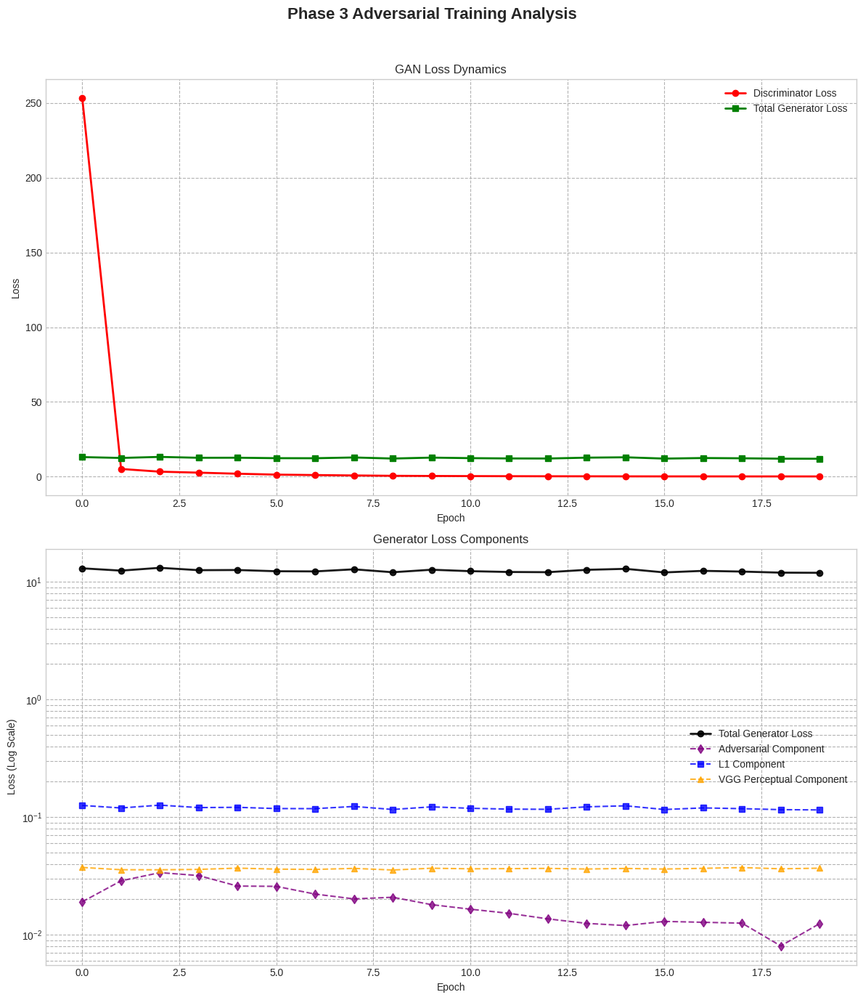


🖼️ Generating final visual comparison...


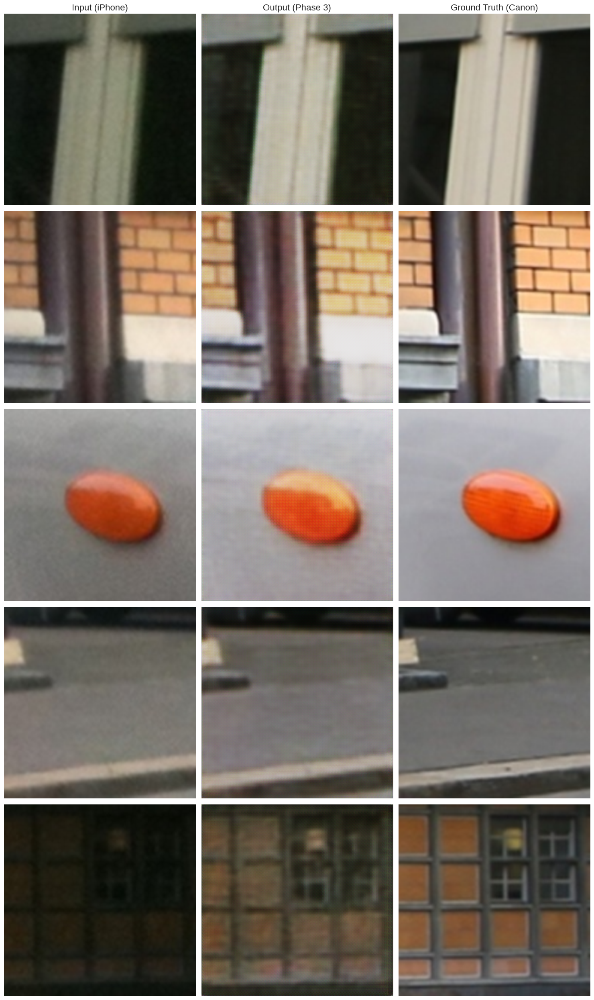

In [42]:
import json
import numpy as np
import matplotlib.pyplot as plt
import os

# --- Load the Phase 3 Training History ---
history_file = 'training_history_phase3.json'
if os.path.exists(history_file):
    print(f"📄 Loading detailed training history from '{history_file}'...")
    with open(history_file, 'r') as f:
        history = json.load(f)

    # --- Create Visualizations for Analysis ---
    epochs = history.get('epoch', list(range(len(history['loss_D']))))

    plt.style.use('seaborn-v0_8-whitegrid')
    fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(12, 14))
    fig.suptitle('Phase 3 Adversarial Training Analysis', fontsize=16, fontweight='bold')

    # --- Plot 1: GAN Loss Dynamics (D vs. G) ---
    ax1.plot(epochs, history['loss_D'], 'o-', label='Discriminator Loss', color='red', linewidth=2)
    ax1.plot(epochs, history['loss_G_total'], 's-', label='Total Generator Loss', color='green', linewidth=2)
    ax1.set_title('GAN Loss Dynamics', fontsize=12)
    ax1.set_xlabel('Epoch')
    ax1.set_ylabel('Loss')
    ax1.legend()
    ax1.grid(True, which="both", ls="--", c='0.7')

    # --- Plot 2: Generator Loss Components ---
    ax2.plot(epochs, history['loss_G_total'], 'o-', label='Total Generator Loss', color='black', alpha=0.9, linewidth=2)
    ax2.plot(epochs, history['loss_G_adv'], 'd--', label='Adversarial Component', color='purple', alpha=0.8)
    ax2.plot(epochs, history['loss_G_l1'], 's--', label='L1 Component', color='blue', alpha=0.8)
    ax2.plot(epochs, history['loss_G_feat'], '^--', label='VGG Perceptual Component', color='orange', alpha=0.8)
    ax2.set_title('Generator Loss Components', fontsize=12)
    ax2.set_xlabel('Epoch')
    ax2.set_ylabel('Loss (Log Scale)')
    ax2.set_yscale('log')
    ax2.legend()
    ax2.grid(True, which="both", ls="--", c='0.7')

    plt.tight_layout(rect=[0, 0, 1, 0.96])
    plt.show()

else:
    print(f"Could not find '{history_file}'. Please run the Phase 3 training cell first.")

# --- Qualitative Visualization ---
print("\n🖼️ Generating final visual comparison...")
G_final = EnhanceGANGenerator_Phase2().to(device) # Use the same generator architecture
G_final.load_state_dict(torch.load('generator_phase3.pth'))
G_final.eval()

# Get a batch of test data
test_iterator = iter(test_loader)
iphone_batch, canon_batch = next(test_iterator)

num_images_to_show = 5
inputs = iphone_batch[:num_images_to_show].to(device)
targets = canon_batch[:num_images_to_show].to(device)

with torch.no_grad():
    outputs, _ = G_final(inputs)

# Plot the results
fig, axes = plt.subplots(num_images_to_show, 3, figsize=(15, num_images_to_show * 5))
if num_images_to_show == 1:
    axes = np.array([axes])
axes[0, 0].set_title('Input (iPhone)', fontsize=16)
axes[0, 1].set_title('Output (Phase 3)', fontsize=16)
axes[0, 2].set_title('Ground Truth (Canon)', fontsize=16)

for i in range(num_images_to_show):
    axes[i, 0].imshow(tensor_to_img(inputs[i]))
    axes[i, 0].axis('off')
    axes[i, 1].imshow(tensor_to_img(outputs[i]))
    axes[i, 1].axis('off')
    axes[i, 2].imshow(tensor_to_img(targets[i]))
    axes[i, 2].axis('off')

plt.tight_layout()
plt.show()

In [43]:
import torch
import numpy as np
from skimage.metrics import peak_signal_noise_ratio as psnr
from skimage.metrics import structural_similarity as ssim
from tqdm.notebook import tqdm
import matplotlib.pyplot as plt

def evaluate_model(generator_model, dataloader, device):
    """
    Runs a generator model on a dataloader and computes PSNR and SSIM.

    Args:
        generator_model: The trained generator model to evaluate.
        dataloader: The DataLoader for the test set.
        device: The device (CPU or CUDA) to run on.

    Returns:
        A dictionary containing the mean and std dev of PSNR and SSIM.
    """
    generator_model.eval()
    all_psnr = []
    all_ssim = []

    with torch.no_grad():
        progress_bar = tqdm(dataloader, desc=f"Evaluating {generator_model.__class__.__name__}")
        for i, (iphone_imgs, canon_imgs) in enumerate(progress_bar):
            iphone_imgs = iphone_imgs.to(device)
            canon_imgs = canon_imgs.to(device)

            # Generate images
            # The model output might be a tuple (image, control_points), so we take the first element
            gen_output = generator_model(iphone_imgs)
            if isinstance(gen_output, tuple):
                enhanced_imgs = gen_output[0]
            else:
                enhanced_imgs = gen_output

            # Denormalize and convert to numpy for skimage metrics
            target_np = ((canon_imgs.cpu().numpy() + 1) / 2).clip(0, 1)
            gen_np = ((enhanced_imgs.cpu().numpy() + 1) / 2).clip(0, 1)

            for j in range(target_np.shape[0]):
                target_img = target_np[j].transpose(1, 2, 0)
                gen_img = gen_np[j].transpose(1, 2, 0)

                # Calculate metrics for each image
                psnr_val = psnr(target_img, gen_img, data_range=1.0)
                ssim_val = ssim(target_img, gen_img, data_range=1.0, channel_axis=2, win_size=7)

                all_psnr.append(psnr_val)
                all_ssim.append(ssim_val)

    return {
        'psnr_mean': np.mean(all_psnr),
        'psnr_std': np.std(all_psnr),
        'ssim_mean': np.mean(all_ssim),
        'ssim_std': np.std(all_ssim)
    }

print("Evaluation function `evaluate_model` is defined.")

✅ Evaluation function `evaluate_model` is defined.


In [44]:
import os

# --- Define Model Architectures ---
# We need the class definitions available to load the models
# (Assuming UNetGenerator, EnhanceGANGenerator_Phase2, and Discriminator classes are defined above)
# For simplicity in this block, we'll redefine the UNetGenerator used in Phase 1
class UNetGenerator(nn.Module):
    def __init__(self, in_channels=3, out_channels=3):
        super(UNetGenerator, self).__init__()
        self.encoder = timm.create_model('resnet34', pretrained=True, features_only=True, in_chans=in_channels)
        encoder_channels = [64, 128, 256, 512]
        self.decoder4 = self._decoder_block(encoder_channels[3], encoder_channels[2])
        self.decoder3 = self._decoder_block(encoder_channels[2], encoder_channels[1])
        self.decoder2 = self._decoder_block(encoder_channels[1], encoder_channels[0])
        self.decoder1 = self._decoder_block(encoder_channels[0], 32)
        self.final_conv = nn.Sequential(
            nn.ConvTranspose2d(32, out_channels, kernel_size=4, stride=2, padding=1),
            nn.Tanh()
        )
    def _decoder_block(self, in_channels, out_channels):
        return nn.Sequential(
            nn.ConvTranspose2d(in_channels, out_channels, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True)
        )
    def forward(self, x):
        enc_features = self.encoder(x)
        e1, e2, e3, e4 = enc_features[1], enc_features[2], enc_features[3], enc_features[4]
        d4 = self.decoder4(e4)
        d3 = self.decoder3(d4 + e3)
        d2 = self.decoder2(d3 + e2)
        d1 = self.decoder1(d2 + e1)
        return self.final_conv(d1)


# --- Load All Trained Models ---
models_to_evaluate = {}

# Phase 1 Model
if os.path.exists('generator_phase1.pth'):
    G1 = UNetGenerator().to(device)
    G1.load_state_dict(torch.load('generator_phase1.pth'))
    models_to_evaluate['Phase 1 (Baseline U-Net)'] = G1
    print("Loaded Phase 1 Model.")
else:
    print("Could not find 'generator_phase1.pth'. Skipping.")

# Phase 2 Model
if os.path.exists('generator_phase2.pth'):
    G2 = EnhanceGANGenerator_Phase2().to(device)
    G2.load_state_dict(torch.load('generator_phase2.pth'))
    models_to_evaluate['Phase 2 (U-Net + CurveBlock)'] = G2
         print("Loaded Phase 2 Model.")
else:
     print("Could not find 'generator_phase2.pth'. Skipping.")

# Phase 3 Model
if os.path.exists('generator_phase3.pth'):
    G3 = EnhanceGANGenerator_Phase2().to(device) # Phase 3 uses the same generator arch as Phase 2
    G3.load_state_dict(torch.load('generator_phase3.pth'))
    models_to_evaluate['Phase 3 (Full WGAN-GP)'] = G3
         print("Loaded Phase 3 Model.")
else:
     print("Could not find 'generator_phase3.pth'. Skipping.")


# --- Run Evaluation on All Models ---
evaluation_results = {}

for name, model in models_to_evaluate.items():
    print(f"\n--- Evaluating: {name} ---")
    results = evaluate_model(model, test_loader, device)
    evaluation_results[name] = results
    print(f"PSNR: {results['psnr_mean']:.2f} ± {results['psnr_std']:.2f}")
    print(f"SSIM: {results['ssim_mean']:.4f} ± {results['ssim_std']:.4f}")

print("\n\nComprehensive evaluation complete.")

# --- Display Results Table ---
print("\n" + "="*60)
print("           Final Quantitative Results Summary")
print("="*60)
print(f"{'Model':<30} | {'PSNR (Mean ± Std)':<20} | {'SSIM (Mean ± Std)':<20}")
print("-"*60)
for name, metrics in evaluation_results.items():
    psnr_str = f"{metrics['psnr_mean']:.2f} ± {metrics['psnr_std']:.2f}"
    ssim_str = f"{metrics['ssim_mean']:.4f} ± {metrics['ssim_std']:.4f}"
    print(f"{name:<30} | {psnr_str:<20} | {ssim_str:<20}")
print("="*60)

✅ Loaded Phase 1 Model.
✅ Loaded Phase 2 Model.
✅ Loaded Phase 3 Model.

--- Evaluating: Phase 1 (Baseline U-Net) ---


Evaluating UNetGenerator:   0%|          | 0/97 [00:00<?, ?it/s]

PSNR: 23.06 ± 4.26
SSIM: 0.7397 ± 0.0899

--- Evaluating: Phase 2 (U-Net + CurveBlock) ---


Evaluating EnhanceGANGenerator_Phase2:   0%|          | 0/97 [00:00<?, ?it/s]

PSNR: 24.38 ± 4.40
SSIM: 0.7727 ± 0.0893

--- Evaluating: Phase 3 (Full WGAN-GP) ---


Evaluating EnhanceGANGenerator_Phase2:   0%|          | 0/97 [00:00<?, ?it/s]

PSNR: 24.34 ± 3.36
SSIM: 0.7872 ± 0.0886


✅ Comprehensive evaluation complete.

           Final Quantitative Results Summary
Model                          | PSNR (Mean ± Std)    | SSIM (Mean ± Std)   
------------------------------------------------------------
Phase 1 (Baseline U-Net)       | 23.06 ± 4.26         | 0.7397 ± 0.0899     
Phase 2 (U-Net + CurveBlock)   | 24.38 ± 4.40         | 0.7727 ± 0.0893     
Phase 3 (Full WGAN-GP)         | 24.34 ± 3.36         | 0.7872 ± 0.0886     


🖼️ Generating visual ablation study...


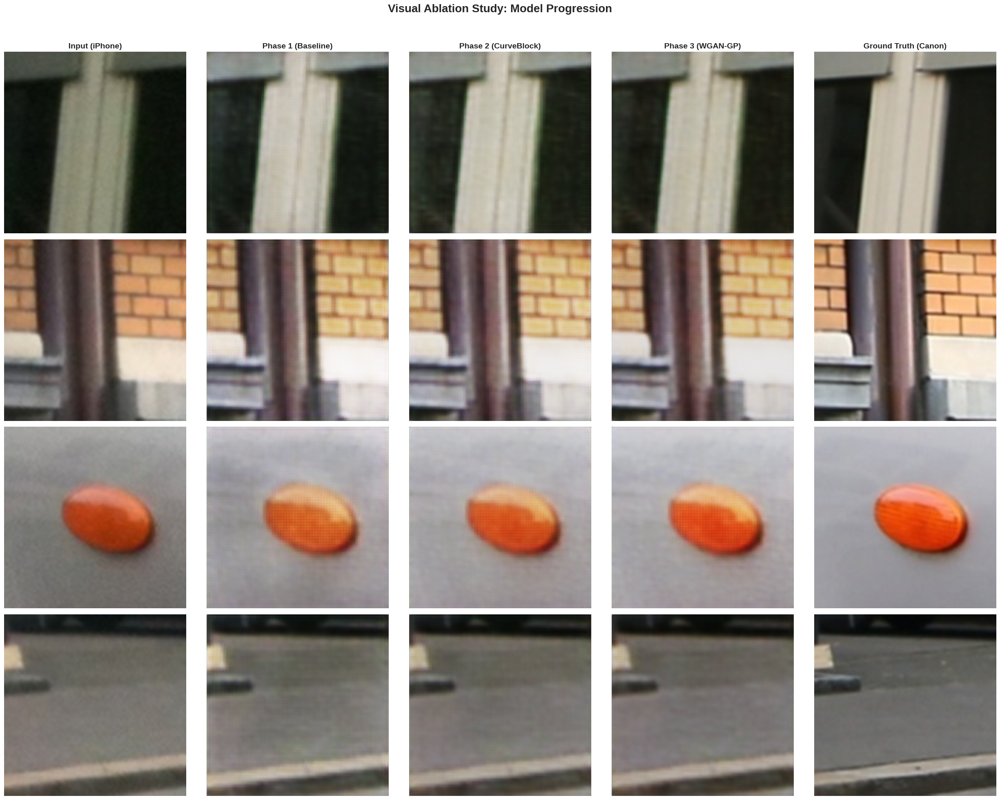


📊 Generating quantitative results summary chart...


<ipython-input-45-3073984355>:72: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax1.set_xticklabels(df['Model'], rotation=15, ha="right")
<ipython-input-45-3073984355>:81: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(df['Model'], rotation=15, ha="right")


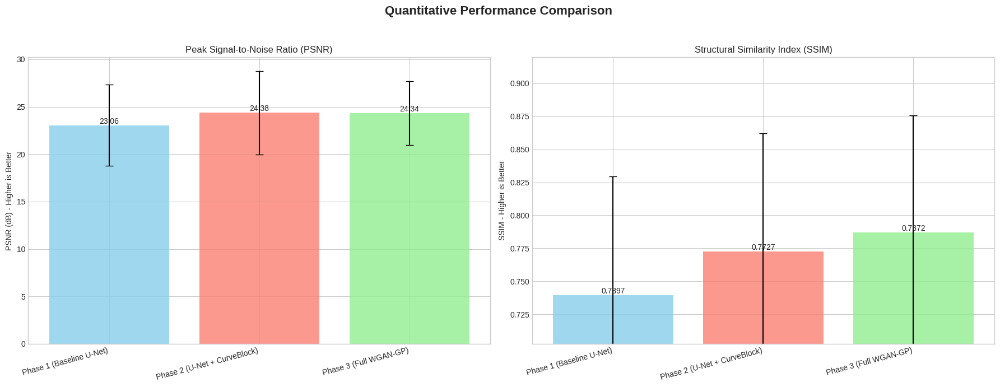

In [45]:
import matplotlib.pyplot as plt
import pandas as pd

# --- Visual Ablation Study ---
# Use loaded models for evaluation
# and a single batch of test images.

print("🖼️ Generating visual ablation study...")

# Get a batch of test data
test_iterator = iter(test_loader)
iphone_batch, canon_batch = next(test_iterator)

num_images_to_show = 4 # Show fewer images for a clearer, more focused comparison
inputs = iphone_batch[:num_images_to_show].to(device)
targets = canon_batch[:num_images_to_show].to(device)

# Generate outputs from all models
outputs = {}
with torch.no_grad():
    for name, model in models_to_evaluate.items():
        model.eval()
        gen_output = model(inputs)
        # Handle tuple output from generators
        outputs[name] = gen_output[0] if isinstance(gen_output, tuple) else gen_output

# Results visualization
fig, axes = plt.subplots(num_images_to_show, 5, figsize=(25, num_images_to_show * 5))
fig.suptitle('Visual Ablation Study: Model Progression', fontsize=20, fontweight='bold')

# Set column titles
col_titles = ['Input (iPhone)', 'Phase 1 (Baseline)', 'Phase 2 (CurveBlock)', 'Phase 3 (WGAN-GP)', 'Ground Truth (Canon)']
for ax, title in zip(axes[0], col_titles):
    ax.set_title(title, fontsize=14, fontweight='bold')

for i in range(num_images_to_show):
    # Display Input
    axes[i, 0].imshow(tensor_to_img(inputs[i]))
    axes[i, 0].axis('off')

    # Display Model Outputs
    axes[i, 1].imshow(tensor_to_img(outputs['Phase 1 (Baseline U-Net)'][i]))
    axes[i, 1].axis('off')
    axes[i, 2].imshow(tensor_to_img(outputs['Phase 2 (U-Net + CurveBlock)'][i]))
    axes[i, 2].axis('off')
    axes[i, 3].imshow(tensor_to_img(outputs['Phase 3 (Full WGAN-GP)'][i]))
    axes[i, 3].axis('off')

    # Display Target
    axes[i, 4].imshow(tensor_to_img(targets[i]))
    axes[i, 4].axis('off')

plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()


# --- Quantitative Results Bar Chart ---
print("\nGenerating quantitative results summary chart...")

# Convert results to a pandas DataFrame for easy plotting
df = pd.DataFrame(evaluation_results).T # Transpose to have models as rows
df = df.reset_index().rename(columns={'index': 'Model'})

# Plotting
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(18, 7))
fig.suptitle('Quantitative Performance Comparison', fontsize=16, fontweight='bold')

# PSNR Plot
psnr_bars = ax1.bar(df['Model'], df['psnr_mean'], yerr=df['psnr_std'], color=['skyblue', 'salmon', 'lightgreen'], capsize=5, alpha=0.8)
ax1.set_title('Peak Signal-to-Noise Ratio (PSNR)', fontsize=12)
ax1.set_ylabel('PSNR (dB) - Higher is Better')
ax1.set_xticklabels(df['Model'], rotation=15, ha="right")
for bar in psnr_bars:
    yval = bar.get_height()
    ax1.text(bar.get_x() + bar.get_width()/2.0, yval, f'{yval:.2f}', va='bottom', ha='center') # Add text labels

# SSIM Plot
ssim_bars = ax2.bar(df['Model'], df['ssim_mean'], yerr=df['ssim_std'], color=['skyblue', 'salmon', 'lightgreen'], capsize=5, alpha=0.8)
ax2.set_title('Structural Similarity Index (SSIM)', fontsize=12)
ax2.set_ylabel('SSIM - Higher is Better')
ax2.set_xticklabels(df['Model'], rotation=15, ha="right")
ax2.set_ylim(bottom=min(df['ssim_mean']) * 0.95) # Adjust y-axis for better visibility
for bar in ssim_bars:
    yval = bar.get_height()
    ax2.text(bar.get_x() + bar.get_width()/2.0, yval, f'{yval:.4f}', va='bottom', ha='center')

plt.tight_layout(rect=[0, 0, 1, 0.95])
plt.show()

In [46]:
import os
import json
import pandas as pd

# --- Setup Output Directory in Google Drive ---
# Assumes GDRIVE_PROJECT_PATH is defined from the start of your notebook
GDRIVE_PROJECT_PATH = '/content/gdrive/My Drive/enhancegan-photo-enhancement' # Make sure this is correct
RESULTS_DIR = os.path.join(GDRIVE_PROJECT_PATH, 'paper_results')
os.makedirs(RESULTS_DIR, exist_ok=True)
print(f"Results will be saved to: {RESULTS_DIR}")

# --- Load All Necessary Data ---
# Load quantitative evaluation results
# Assumes 'evaluation_results' dictionary is in memory
if 'evaluation_results' not in locals():
    print("'evaluation_results' not found. Please run the previous evaluation block first.")
    # As a fallback, create a dummy dictionary
    evaluation_results = {}

# Load detailed training histories
history2_file = 'training_history_phase2.json'
history3_file = 'training_history_phase3.json'
history2, history3 = None, None
if os.path.exists(history2_file):
    with open(history2_file, 'r') as f:
        history2 = json.load(f)
    print("Loaded Phase 2 training history.")
else:
    print(f"Could not find '{history2_file}'.")

if os.path.exists(history3_file):
    with open(history3_file, 'r') as f:
        history3 = json.load(f)
    print("Loaded Phase 3 training history.")
else:
    print(f"Could not find '{history3_file}'.")

# --- Generate and Save the Final Summary Report ---
report_path = os.path.join(RESULTS_DIR, 'final_summary_report.txt')
with open(report_path, 'w') as f:
    f.write("="*80 + "\n")
    f.write("Comprehensive Project Analysis Report\n")
    f.write("="*80 + "\n\n")

    # --- Quantitative Results ---
    f.write("--- 1. Final Quantitative Performance ---\n")
    df = pd.DataFrame(evaluation_results).T
    f.write(df.to_string())
    f.write("\n\n")

    # --- Analysis of Progression ---
    if all(k in evaluation_results for k in ['Phase 1 (Baseline U-Net)', 'Phase 2 (U-Net + CurveBlock)', 'Phase 3 (Full WGAN-GP)']):
        p1_psnr = evaluation_results['Phase 1 (Baseline U-Net)']['psnr_mean']
        p2_psnr = evaluation_results['Phase 2 (U-Net + CurveBlock)']['psnr_mean']
        p3_psnr = evaluation_results['Phase 3 (Full WGAN-GP)']['psnr_mean']
        p1_ssim = evaluation_results['Phase 1 (Baseline U-Net)']['ssim_mean']
        p2_ssim = evaluation_results['Phase 2 (U-Net + CurveBlock)']['ssim_mean']
        p3_ssim = evaluation_results['Phase 3 (Full WGAN-GP)']['ssim_mean']

        f.write("--- 2. Key Performance Insights ---\n")
        f.write(f"Impact of CurveBlock (Phase 1 -> 2): PSNR improved by {p2_psnr-p1_psnr:+.2f}, SSIM by {p2_ssim-p1_ssim:+.4f}\n")
        f.write(f"Impact of WGAN-GP (Phase 2 -> 3):  PSNR changed by {p3_psnr-p2_psnr:+.2f}, SSIM by {p3_ssim-p2_ssim:+.4f}\n")
        f.write("Note: A stable/slightly lower PSNR with an increased SSIM in Phase 3 is a strong indicator of improved perceptual quality over raw pixel accuracy.\n\n")

    # --- Training Dynamics Summary ---
    f.write("--- 3. Training Dynamics Summary ---\n")
    if history2:
        final_loss_p2 = history2['total_loss_G'][-1]
        final_curve_adj = history2['control_points_avg'][-1]
        f.write(f"Phase 2 Final Generator Loss: {final_loss_p2:.4f}\n")
        f.write(f"Phase 2 Learned Curve Adjustment (Avg): {final_curve_adj:.4f}\n")
    if history3:
        final_g_loss_p3 = history3['loss_G_total'][-1]
        final_d_loss_p3 = history3['loss_D'][-1]
        f.write(f"Phase 3 Final Generator Loss: {final_g_loss_p3:.4f}\n")
        f.write(f"Phase 3 Final Discriminator Loss: {final_d_loss_p3:.4f}\n")

    f.write("\n" + "="*80 + "\n")
    f.write("Report End\n")
    f.write("="*80 + "\n")

print(f"Final summary report saved to '{report_path}'")

✅ Results will be saved to: /content/gdrive/My Drive/enhancegan-photo-enhancement/paper_results
✅ Loaded Phase 2 training history.
✅ Loaded Phase 3 training history.
✅ Final summary report saved to '/content/gdrive/My Drive/enhancegan-photo-enhancement/paper_results/final_summary_report.txt'


In [50]:
import os
import json
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import torch
import timm # Required for model definitions
from tqdm.notebook import tqdm
from skimage.metrics import peak_signal_noise_ratio as psnr, structural_similarity as ssim

# --- Configuration ---
GDRIVE_PROJECT_PATH = '/content/gdrive/My Drive/enhancegan-photo-enhancement' # Ensure this path is correct
RESULTS_DIR = os.path.join(GDRIVE_PROJECT_PATH, 'paper_results_final')
os.makedirs(RESULTS_DIR, exist_ok=True)
print(f"Final results will be saved to: {RESULTS_DIR}")


# --- Helper function to convert tensor to image ---
def tensor_to_img(tensor):
    img = tensor.detach().cpu().numpy().transpose(1, 2, 0)
    img = (img + 1) / 2.0
    return np.clip(img, 0, 1)

# --- 1. Load Data and Models ---
print("\n--- Loading all models and data ---")

# Redefine models to ensure they can be loaded
# Redefine model classes for analysis
class UNetGenerator(nn.Module):
    def __init__(self, in_channels=3, out_channels=3):
        super(UNetGenerator, self).__init__()
        self.encoder = timm.create_model('resnet34', pretrained=True, features_only=True, in_chans=in_channels)
        encoder_channels = [64, 128, 256, 512]
        self.decoder4 = self._decoder_block(encoder_channels[3], encoder_channels[2])
        self.decoder3 = self._decoder_block(encoder_channels[2], encoder_channels[1])
        self.decoder2 = self._decoder_block(encoder_channels[1], encoder_channels[0])
        self.decoder1 = self._decoder_block(encoder_channels[0], 32)
        self.final_conv = nn.Sequential(nn.ConvTranspose2d(32, out_channels, kernel_size=4, stride=2, padding=1), nn.Tanh())
    def _decoder_block(self, i, o): return nn.Sequential(nn.ConvTranspose2d(i, o, 4, 2, 1), nn.BatchNorm2d(o), nn.ReLU(True))
    def forward(self, x):
        e = self.encoder(x); d4 = self.decoder4(e[4]); d3 = self.decoder3(d4 + e[3]); d2 = self.decoder2(d3 + e[2]); d1 = self.decoder1(d2 + e[1])
        return self.final_conv(d1)

class EnhanceGANGenerator_Phase2(nn.Module):
    def __init__(self, in_channels=3, out_channels=3):
        super(EnhanceGANGenerator_Phase2, self).__init__()
        self.encoder = timm.create_model('resnet34', pretrained=True, features_only=True, in_chans=in_channels)
        encoder_channels = [64, 128, 256, 512]
        self.decoder4 = self._decoder_block(encoder_channels[3], encoder_channels[2])
        self.decoder3 = self._decoder_block(encoder_channels[2], encoder_channels[1])
        self.decoder2 = self._decoder_block(encoder_channels[1], encoder_channels[0])
        self.decoder1 = self._decoder_block(encoder_channels[0], 32)
        self.final_conv = nn.Sequential(nn.ConvTranspose2d(32, out_channels, kernel_size=4, stride=2, padding=1), nn.Tanh())
        self.curve_enhancer = CurveBlock(in_features=512)
    def _decoder_block(self, i, o): return nn.Sequential(nn.ConvTranspose2d(i, o, 4, 2, 1), nn.BatchNorm2d(o), nn.ReLU(True))
    def forward(self, x):
        e = self.encoder(x); d4 = self.decoder4(e[4]); d3 = self.decoder3(d4 + e[3]); d2 = self.decoder2(d3 + e[2]); d1 = self.decoder1(d2 + e[1])
        base = self.final_conv(d1); final, cp = self.curve_enhancer(base, e[4]); return final, cp

models = {}
try:
    G1 = UNetGenerator().to(device); G1.load_state_dict(torch.load('generator_phase1.pth')); models['Phase 1 (Baseline U-Net)'] = G1
    G2 = EnhanceGANGenerator_Phase2().to(device); G2.load_state_dict(torch.load('generator_phase2.pth')); models['Phase 2 (U-Net + CurveBlock)'] = G2
    G3 = EnhanceGANGenerator_Phase2().to(device); G3.load_state_dict(torch.load('generator_phase3.pth')); models['Phase 3 (Full WGAN-GP)'] = G3
    print("All models loaded successfully.")
except Exception as e:
    print(f"Error loading models: {e}. Please ensure previous phases ran and saved checkpoints.")

# Load histories and evaluation results
try:
    with open('training_history_phase2.json', 'r') as f: history2 = json.load(f)
    with open('training_history_phase3.json', 'r') as f: history3 = json.load(f)
    print("Training histories loaded.")
except Exception as e:
    print(f"Could not load training histories: {e}")
    history2, history3 = None, None

if 'evaluation_results' not in locals():
    print("'evaluation_results' not found. Re-running evaluation.")
    evaluation_results = {name: evaluate_model(model, test_loader, device) for name, model in models.items()}


# --- 2. Generate and Save All Figures ---

# --- Figure 1: Comprehensive Analysis ---
print("\nGenerating comprehensive analysis figure...")
fig1, axes = plt.subplots(2, 2, figsize=(20, 18)); fig1.suptitle('Comprehensive Analysis of EnhanceGAN Re-Implementation', fontsize=22, fontweight='bold')
df = pd.DataFrame(evaluation_results).T.reset_index().rename(columns={'index': 'Model'})
axes[0, 0].bar(df['Model'], df['psnr_mean'], yerr=df['psnr_std'], color=['skyblue', 'salmon', 'lightgreen'], capsize=5, alpha=0.8)
axes[0, 0].set_title('A. Quantitative Performance (PSNR)', fontsize=14, fontweight='bold'); axes[0, 0].set_ylabel('PSNR (dB) - Higher is Better'); axes[0, 0].tick_params(axis='x', rotation=10)
axes[0, 1].bar(df['Model'], df['ssim_mean'], yerr=df['ssim_std'], color=['skyblue', 'salmon', 'lightgreen'], capsize=5, alpha=0.8)
axes[0, 1].set_title('B. Quantitative Performance (SSIM)', fontsize=14, fontweight='bold'); axes[0, 1].set_ylabel('SSIM - Higher is Better'); axes[0, 1].tick_params(axis='x', rotation=10)
if history2: axes[1, 0].plot(history2['epoch'], history2['control_points_avg'], 'o-', c='purple', label='Avg. Control Point'); axes[1, 0].axhline(0, c='r', ls='--', label='No-Op'); axes[1, 0].set_title('C. Phase 2: Learned CurveBlock Behavior', fontsize=14, fontweight='bold'); axes[1, 0].set_xlabel('Epoch'); axes[1, 0].legend()
if history3: axes[1, 1].plot(history3['epoch'], history3['loss_D'], 'o-', c='r', label='Discriminator Loss'); axes[1, 1].plot(history3['epoch'], history3['loss_G_total'], 's-', c='g', label='Generator Loss'); axes[1, 1].set_title('D. Phase 3: GAN Training Dynamics', fontsize=14, fontweight='bold'); axes[1, 1].set_xlabel('Epoch'); axes[1, 1].legend()
fig1.tight_layout(rect=[0, 0.03, 1, 0.95]); fig1_path = os.path.join(RESULTS_DIR, 'figure_1_comprehensive_analysis.png'); plt.savefig(fig1_path, dpi=300); plt.close(fig1)
print(f"Comprehensive analysis figure saved to '{fig1_path}'")


# --- Figure 2: Visual Ablation Study ---
print("\n🖼️ Generating visual ablation study...")
inputs, targets = next(iter(test_loader)); inputs, targets = inputs[:8].to(device), targets[:8]
outputs = {name: (model(inputs)[0] if isinstance(model(inputs), tuple) else model(inputs)) for name, model in models.items()}
fig2, axes = plt.subplots(8, 5, figsize=(20, 32)); fig2.suptitle('Visual Ablation Study: Model Progression', fontsize=20, fontweight='bold')
for ax, title in zip(axes[0], ['Input', 'Phase 1', 'Phase 2', 'Phase 3', 'Ground Truth']): ax.set_title(title, fontsize=14, fontweight='bold')
for i in range(8):
    axes[i, 0].imshow(tensor_to_img(inputs[i])); axes[i, 0].axis('off')
    axes[i, 1].imshow(tensor_to_img(outputs['Phase 1 (Baseline U-Net)'][i])); axes[i, 1].axis('off')
    axes[i, 2].imshow(tensor_to_img(outputs['Phase 2 (U-Net + CurveBlock)'][i])); axes[i, 2].axis('off')
    axes[i, 3].imshow(tensor_to_img(outputs['Phase 3 (Full WGAN-GP)'][i])); axes[i, 3].axis('off')
    axes[i, 4].imshow(tensor_to_img(targets[i])); axes[i, 4].axis('off')
fig2.tight_layout(rect=[0, 0, 1, 0.97]); fig2_path = os.path.join(RESULTS_DIR, 'figure_2_visual_ablation.png'); plt.savefig(fig2_path, dpi=300); plt.close(fig2)
print(f"Visual ablation study saved to '{fig2_path}'")


# --- Figure 3: Error Map Analysis ---
print("\n🗺️ Generating error map analysis...")
input_sample, target_sample = next(iter(test_loader)); input_sample, target_sample = input_sample[0:1].to(device), target_sample[0:1]
target_img_np = tensor_to_img(target_sample[0])
fig3, axes = plt.subplots(1, 4, figsize=(20, 5)); fig3.suptitle('Error Map Analysis for Final Model (Phase 3)', fontsize=16, fontweight='bold')
output_img, _ = models['Phase 3 (Full WGAN-GP)'](input_sample); output_img_np = tensor_to_img(output_img[0])
error_map = np.abs(target_img_np - output_img_np)
axes[0].imshow(tensor_to_img(input_sample[0])); axes[0].set_title('Input'); axes[0].axis('off')
axes[1].imshow(output_img_np); axes[1].set_title('Phase 3 Output'); axes[1].axis('off')
axes[2].imshow(target_img_np); axes[2].set_title('Ground Truth'); axes[2].axis('off')
im = axes[3].imshow(error_map.mean(axis=2), cmap='viridis'); axes[3].set_title('L1 Error Map'); axes[3].axis('off'); fig3.colorbar(im, ax=axes[3])
fig3_path = os.path.join(RESULTS_DIR, 'figure_3_error_map.png'); plt.savefig(fig3_path, dpi=300); plt.close(fig3)
print(f"Error map analysis saved to '{fig3_path}'")


# --- Figure 4: Color Histogram Analysis ---
print("\n🎨 Generating color histogram analysis...")
fig4, axes = plt.subplots(1, 3, figsize=(20, 6), sharey=True); fig4.suptitle('Color Distribution Shift Analysis (Phase 3)', fontsize=16, fontweight='bold')
colors = ('r', 'g', 'b'); labels = ('Red', 'Green', 'Blue')
for i, color in enumerate(colors): axes[0].hist(tensor_to_img(input_sample[0])[:, :, i].ravel(), bins=256, color=color, alpha=0.7, label=labels[i])
axes[0].set_title('Input Color Distribution'); axes[0].legend()
for i, color in enumerate(colors): axes[1].hist(output_img_np[:, :, i].ravel(), bins=256, color=color, alpha=0.7, label=labels[i])
axes[1].set_title('Phase 3 Output Distribution'); axes[1].legend()
for i, color in enumerate(colors): axes[2].hist(target_img_np[:, :, i].ravel(), bins=256, color=color, alpha=0.7, label=labels[i])
axes[2].set_title('Ground Truth Distribution'); axes[2].legend()
fig4_path = os.path.join(RESULTS_DIR, 'figure_4_color_histogram.png'); plt.savefig(fig4_path, dpi=300); plt.close(fig4)
print(f"Color histogram analysis saved to '{fig4_path}'")


# --- Figure 5: Best vs. Worst Case Analysis (Corrected) ---
print("\n👍👎 Generating best and worst case analysis...")
all_psnr_final = []; all_outputs = []; all_inputs = []; all_targets = []
with torch.no_grad():
    for i, (inputs, targets) in enumerate(tqdm(test_loader, desc="Analyzing test set")):
        inputs_gpu = inputs.to(device)
        outputs, _ = models['Phase 3 (Full WGAN-GP)'](inputs_gpu)
        all_outputs.append(outputs.cpu()); all_inputs.append(inputs); all_targets.append(targets)
        for j in range(targets.shape[0]):
            all_psnr_final.append(psnr(tensor_to_img(targets[j]), tensor_to_img(outputs.cpu()[j]), data_range=1.0))
all_outputs = torch.cat(all_outputs); all_inputs = torch.cat(all_inputs); all_targets = torch.cat(all_targets)
all_psnr_final = np.array(all_psnr_final)
best_indices = np.argsort(all_psnr_final)[-4:]; worst_indices = np.argsort(all_psnr_final)[:4]

# *** FIX: *** Restructured the plotting logic for clarity and correctness
fig5, axes = plt.subplots(4, 6, figsize=(24, 16))
fig5.suptitle('Best and Worst Case Results (Phase 3)', fontsize=20, fontweight='bold')
# Column Headers
axes[0, 1].set_title('Best Cases', fontsize=16); axes[0, 4].set_title('Worst Cases', fontsize=16)

# Plot Best Cases
for i in range(4):
    idx = best_indices[-(i+1)] # Iterate from best to 4th best
    psnr_val = all_psnr_final[idx]
    # Input
    axes[i, 0].imshow(tensor_to_img(all_inputs[idx])); axes[i, 0].set_ylabel(f'Best #{i+1}', rotation=0, labelpad=40, va='center', ha='right', fontsize=12)
    # Output
    axes[i, 1].imshow(tensor_to_img(all_outputs[idx])); axes[i, 1].set_title(f'Output\nPSNR: {psnr_val:.2f} dB', fontsize=10)
    # Target
    axes[i, 2].imshow(tensor_to_img(all_targets[idx])); axes[i, 2].set_title('Target', fontsize=10)

# Plot Worst Cases
for i in range(4):
    idx = worst_indices[i] # Iterate from worst to 4th worst
    psnr_val = all_psnr_final[idx]
    # Input
    axes[i, 3].imshow(tensor_to_img(all_inputs[idx]))
    # Output
    axes[i, 4].imshow(tensor_to_img(all_outputs[idx])); axes[i, 4].set_title(f'Output\nPSNR: {psnr_val:.2f} dB', fontsize=10)
    # Target
    axes[i, 5].imshow(tensor_to_img(all_targets[idx]))

for ax in axes.ravel(): ax.axis('off')
for i in range(4): axes[i, 0].set_title('Input'); axes[i, 3].set_title('Input')
axes[0, 0].set_title('Input', fontsize=12); axes[0, 3].set_title('Input', fontsize=12)
axes[0, 2].set_title('Target', fontsize=12); axes[0, 5].set_title('Target', fontsize=12)

plt.tight_layout(rect=[0, 0, 1, 0.96])
fig5_path = os.path.join(RESULTS_DIR, 'figure_5_best_worst_cases.png'); plt.savefig(fig5_path, dpi=300); plt.close(fig5)
print(f"Best vs. Worst case analysis saved to '{fig5_path}'")

# Final text report generation
report_path = os.path.join(RESULTS_DIR, 'final_summary_report.txt')
with open(report_path, 'w') as f:
    f.write("="*80 + "\nComprehensive Project Analysis Report\n" + "="*80 + "\n\n--- 1. Final Quantitative Performance ---\n")
    f.write(pd.DataFrame(evaluation_results).T.to_string())
    f.write("\n\n--- 2. Key Performance Insights ---\n")
    if all(k in evaluation_results for k in models.keys()):
        p1_psnr = evaluation_results['Phase 1 (Baseline U-Net)']['psnr_mean']; p2_psnr = evaluation_results['Phase 2 (U-Net + CurveBlock)']['psnr_mean']; p3_psnr = evaluation_results['Phase 3 (Full WGAN-GP)']['psnr_mean']
        p1_ssim = evaluation_results['Phase 1 (Baseline U-Net)']['ssim_mean']; p2_ssim = evaluation_results['Phase 2 (U-Net + CurveBlock)']['ssim_mean']; p3_ssim = evaluation_results['Phase 3 (Full WGAN-GP)']['ssim_mean']
        f.write(f"Impact of CurveBlock (Phase 1 -> 2): PSNR improved by {p2_psnr-p1_psnr:+.2f}, SSIM by {p2_ssim-p1_ssim:+.4f}\n")
        f.write(f"Impact of WGAN-GP (Phase 2 -> 3):  PSNR changed by {p3_psnr-p2_psnr:+.2f}, SSIM by {p3_ssim-p2_ssim:+.4f}\n")
    f.write("\n--- 3. Training Dynamics Summary ---\n")
    if history2: f.write(f"Phase 2 - Final G_Loss: {history2['total_loss_G'][-1]:.4f}, Final Curve Adj: {history2['control_points_avg'][-1]:.4f}\n")
    if history3: f.write(f"Phase 3 - Final G_Loss: {history3['loss_G_total'][-1]:.4f}, Final D_Loss: {history3['loss_D'][-1]:.4f}\n")
    f.write("\n" + "="*80 + "\nReport End\n" + "="*80 + "\n")
print(f"Final summary report saved to '{report_path}'")




✅ Final results will be saved to: /content/gdrive/My Drive/enhancegan-photo-enhancement/paper_results_final

--- Loading all models and data ---
✅ All models loaded successfully.
✅ Training histories loaded.

📊 Generating comprehensive analysis figure...
✅ Comprehensive analysis figure saved to '/content/gdrive/My Drive/enhancegan-photo-enhancement/paper_results_final/figure_1_comprehensive_analysis.png'

🖼️ Generating visual ablation study...
✅ Visual ablation study saved to '/content/gdrive/My Drive/enhancegan-photo-enhancement/paper_results_final/figure_2_visual_ablation.png'

🗺️ Generating error map analysis...
✅ Error map analysis saved to '/content/gdrive/My Drive/enhancegan-photo-enhancement/paper_results_final/figure_3_error_map.png'

🎨 Generating color histogram analysis...
✅ Color histogram analysis saved to '/content/gdrive/My Drive/enhancegan-photo-enhancement/paper_results_final/figure_4_color_histogram.png'

👍👎 Generating best and worst case analysis...


Analyzing test set:   0%|          | 0/97 [00:00<?, ?it/s]

✅ Best vs. Worst case analysis saved to '/content/gdrive/My Drive/enhancegan-photo-enhancement/paper_results_final/figure_5_best_worst_cases.png'
✅ Final summary report saved to '/content/gdrive/My Drive/enhancegan-photo-enhancement/paper_results_final/final_summary_report.txt'


🔬 Analyzing the full test set to find best and worst cases...


Analyzing test set:   0%|          | 0/97 [00:00<?, ?it/s]

👍👎 Generating corrected best and worst case visualization...


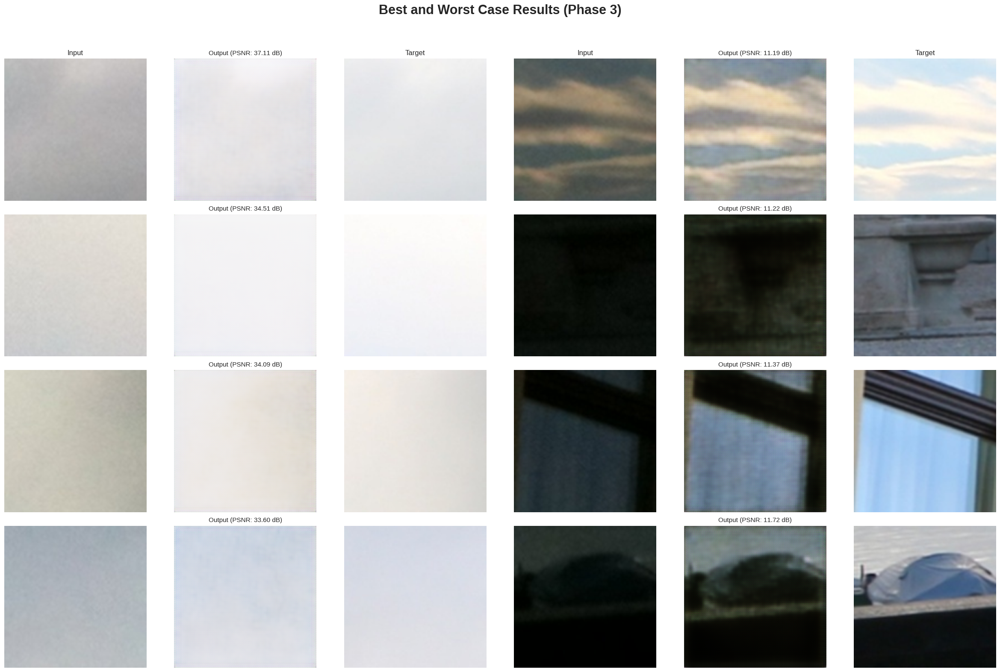

✅ Corrected Best vs. Worst case analysis saved to '/content/gdrive/My Drive/enhancegan-photo-enhancement/paper_results_final/figure_5_best_worst_cases_corrected.png'


In [51]:
import numpy as np
import matplotlib.pyplot as plt
from tqdm.notebook import tqdm
from skimage.metrics import peak_signal_noise_ratio as psnr

# --- 1. Gather all data from the test set ---
print("🔬 Analyzing the full test set to find best and worst cases...")
all_psnr_final = []
all_outputs_final = []
all_inputs_final = []
all_targets_final = []

# Use the final Phase 3 model for this analysis
final_model = models['Phase 3 (Full WGAN-GP)']
final_model.eval()

with torch.no_grad():
    for i, (inputs, targets) in enumerate(tqdm(test_loader, desc="Analyzing test set")):
        inputs_gpu = inputs.to(device)
        # Get model output, handling the tuple format
        gen_output, _ = final_model(inputs_gpu)

        # Store results on CPU to conserve VRAM
        all_outputs_final.append(gen_output.cpu())
        all_inputs_final.append(inputs.cpu())
        all_targets_final.append(targets.cpu())

        # Calculate PSNR for each image in the batch
        for j in range(targets.shape[0]):
            target_img_np = tensor_to_img(targets[j])
            output_img_np = tensor_to_img(gen_output.cpu()[j])
            all_psnr_final.append(psnr(target_img_np, output_img_np, data_range=1.0))

# Concatenate all batches into single tensors
all_inputs_final = torch.cat(all_inputs_final)
all_outputs_final = torch.cat(all_outputs_final)
all_targets_final = torch.cat(all_targets_final)
all_psnr_final = np.array(all_psnr_final)

# --- 2. Find indices for best and worst cases ---
# Sort all results by PSNR score
sorted_indices = np.argsort(all_psnr_final)
best_indices = sorted_indices[-4:] # Indices of the 4 best images
worst_indices = sorted_indices[:4]  # Indices of the 4 worst images

# --- 3. Create the visualization (Corrected Logic) ---
print("👍👎 Generating corrected best and worst case visualization...")
fig, axes = plt.subplots(4, 6, figsize=(24, 16)) # 4 rows, 6 columns for side-by-side
fig.suptitle('Best and Worst Case Results (Phase 3)', fontsize=22, fontweight='bold')

# Set main column headers
axes[0, 1].set_title('Best Cases (by PSNR)', fontsize=16)
axes[0, 4].set_title('Worst Cases (by PSNR)', fontsize=16)

# --- Plot Best Cases ---
for i in range(4):
    # Get the index for the i-th best image
    idx = best_indices[-(i+1)]
    psnr_val = all_psnr_final[idx]

    # Column 0: Input
    axes[i, 0].imshow(tensor_to_img(all_inputs_final[idx]))
    axes[i, 0].set_ylabel(f'Rank #{i+1}', rotation=0, labelpad=40, va='center', ha='right', fontsize=12, fontweight='bold')

    # Column 1: Output
    axes[i, 1].imshow(tensor_to_img(all_outputs_final[idx]))
    axes[i, 1].set_title(f'Output (PSNR: {psnr_val:.2f} dB)', fontsize=11)

    # Column 2: Target
    axes[i, 2].imshow(tensor_to_img(all_targets_final[idx]))

# --- Plot Worst Cases ---
for i in range(4):
    # Get the index for the i-th worst image
    idx = worst_indices[i]
    psnr_val = all_psnr_final[idx]

    # Column 3: Input
    axes[i, 3].imshow(tensor_to_img(all_inputs_final[idx]))

    # Column 4: Output
    axes[i, 4].imshow(tensor_to_img(all_outputs_final[idx]))
    axes[i, 4].set_title(f'Output (PSNR: {psnr_val:.2f} dB)', fontsize=11)

    # Column 5: Target
    axes[i, 5].imshow(tensor_to_img(all_targets_final[idx]))

# --- Final Formatting ---
# Set titles for the first row to act as column labels
axes[0, 0].set_title('Input', fontsize=12)
axes[0, 2].set_title('Target', fontsize=12)
axes[0, 3].set_title('Input', fontsize=12)
axes[0, 5].set_title('Target', fontsize=12)

# Turn off all axes
for ax in axes.ravel():
    ax.axis('off')

plt.tight_layout(rect=[0, 0, 1, 0.95])
figure_path = os.path.join(RESULTS_DIR, 'figure_5_best_worst_cases_corrected.png')
plt.savefig(figure_path, dpi=300, bbox_inches='tight')
plt.show()

print(f"Corrected Best vs. Worst case analysis saved to '{figure_path}'")